# Attractor Networks

Attractor or Hopfield networks store one or more patterns which can be retrieved with partial input.
These networks were inspired by the dynamics of the CA3 region of the hipoccampus, a region associated with memory and face recognition, among others.
In our natural biological memory, we are constantly tasked with retrieving a complete memory item from a partial cue, like a smell or a color.
Alterations of these mechanims could also be linked to pathologies (e.g. post-traumatic stress disorder).

The architecture of these networks are fully connected binary units without layers, where every neuron is both input and output.
New presented patterns update the weights according to an unsupervised Hebbian learning rule, which can be simplified as: "neurons that fire together link together, neurons out of sync fail to link".



In [138]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

from tqdm import tqdm

np.random.seed(123)  # Get reproducible runs

# Parameters
num_neurons = 5

## Simple Nerwork

### Patterns
Patterns are binary and with as many digits as neurons in the network.

[1 0 1 0 1]
[0 1 1 0 1]
[0 1 0 0 1]


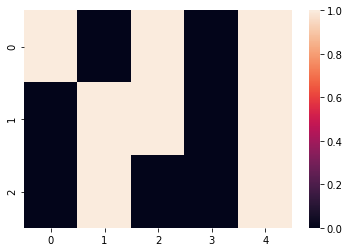

In [161]:
# Make specific simple patterns for explanation
simple_patterns = [np.array([1, 0, 1, 0, 1]), np.array([0, 1, 1, 0, 1]), np.array([0, 1, 0, 0, 1])]
list(map(lambda x: print(x), simple_patterns))

# Simple static plot to quicly give a visual idea
sns.heatmap(simple_patterns)

### Training
Weights represent how much a neuron $ i $ "listens" to a neuron $j$.
This connectivity is represented by notation $W_{i, j}$.

All possible network $W_{i, j}$ in this type of architecture gives rise to a square matrix.

For a all patterns, the Hebbian learning rule is as follows:

$$W_{i, j} = \sum_{p = 0}^{P} (2V_{s, i} - 1) (2V_{s, j} - 1)$$

Main diagonal is set to zeros.

First we will define the methods according to previous instructions:

In [140]:
def _make_diag_zero(array):
    """Takes and array and returns with zeros in main diagonal"""
    
    zeroing_diag = (a := np.tri(array.shape[0], k=-1)) + a.T
    return array * zeroing_diag

def make_weights(pattern):
    """
    Make each element in the pattern as Hebb's rule equation.
    Then matmul to get the weight matrix and make main diagonal
    elements zero.
    """
    
    mod_pattern = 2 * pattern - 1  # Each element as in Hebb's rule equation
    return _make_diag_zero(mod_pattern[:, None] @ mod_pattern[None, :])

def interactive_heatmap_weight(weights, title=""):
    """Create the interactive heatmap and display it"""
    
    neuron_labels = [f"Neuron {num}" for num in range(len(weights))]
    fig = go.Figure(data=go.Heatmap(
                        z = weights,
                        x = neuron_labels,
                        y = neuron_labels,
                )
               )
    fig.update_layout(title = title)
    fig.show()

For a sample pattern:

First simple pattern:


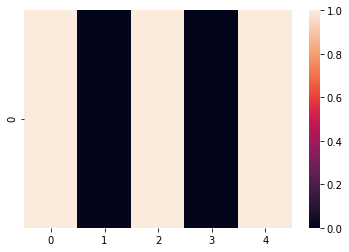

In [141]:
# Choose the first one
first_simple_pattern = simple_patterns[0]

# Make weight matrix
simple_weights = make_weights(first_simple_pattern)

# Interactive plot
interactive_heatmap_weight(simple_weights, "Weights for simple pattern")

# Display reminder of pattern
print("First simple pattern:")
sns.heatmap(first_simple_pattern[None, :])

Now that we have it broken down for one pattern, we need to apply it to all sample patterns. These are the individual weight matrices before adding them up:

In [142]:
simple_weights_list = [make_weights(simple_pattern) for simple_pattern in simple_patterns]

def weight_changes_slider(weight_matrix_list, title=""):
    fig = go.Figure()

    # Traces to each slider step
    for weight_arr in weight_matrix_list:
        fig.add_trace(go.Heatmap(z=weight_arr))

    # Add slider
    steps = []
    for i in range(len(fig.data)):
        step = dict(
            method="update",
            args=[{"visible": [False] * len(fig.data)},
                  {"title": f"{title}" + str(i)}],  # layout attribute
        )
        step["args"][0]["visible"][i] = True  # Display 'i'
        steps.append(step)

    sliders = [dict(
        active=0,
        #currentvalue={"prefix": "Frequency: "},
        pad={"t": 1},
        steps=steps
    )]

    fig.update_layout(
        sliders = sliders,
        title = title,
    )

    fig.show()

weight_changes_slider(simple_weights_list, "Weight matrix ")

If we add all weigth matrices now (note the interactive plot scale changes in colorbar):

We finally arrive to this pattern after adding all weight matrices:


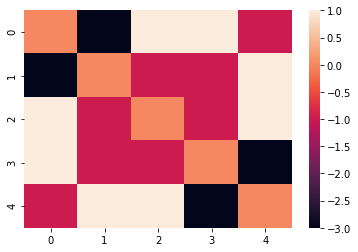

In [143]:
# Cumulative sum saving intermediate states

def get_weights_expanding_sum(weights_list_):
    weights_sum_ = np.zeros_like(weights_list_[0])
    weights_expanding_sum_ = []
    for weight_arr_ in weights_list_:
        weights_sum_ += weight_arr_
        weights_expanding_sum_.append(weights_sum_.copy())
    return weights_sum_, weights_expanding_sum_

weights_sum, weights_expanding_sum = get_weights_expanding_sum(simple_weights_list)
# Display interactive plot
weight_changes_slider(weights_expanding_sum, "Weights cumulative sum of ")

# End result as static plot to compare with each step of the interactive
print("We finally arrive to this pattern after adding all weight matrices:")
sns.heatmap(weights_sum)

### Updating
Activations are calculated every time iteration taking into account:
* Previous iteration activations
* Weight matrix
* Activation function

The activation function is a Heaviside step function:

$$ H[n] = \begin{cases}0,&n<0,\\1,&n\geq 0,\end{cases} $$

The network is updated until convergence, which means that the recovered pattern does not change anymore.
There are cases in which this definition of convergence is not true: the network reaches a state that constantly oscillated between two recovered patterns every additional update.
Remember this is a fully connected unsupervised network trained at the beginning: there is no forward or back propagation, only activation updates to convergence.

First we define the updating function for a single time step:

In [170]:
def get_activations(prev_activations_, sum_weights_):
    return np.heaviside(sum_weights_ @ prev_activations_, 1).astype(int)

The network needs to be initiallized to whatever patter of activations (all ones, zeros, or any other combination of our choice).
Then we define and run the updating loop until convergence:

In [168]:
# Set first activation as all ones
first_activations = np.ones(5, dtype=int)
print(f"First activations: {first_activations}")

def update_network(activations_, weights_sum_):
    # Update loop until convergence
    print("Starting the update loop...")
    prev_activations_ = np.ones_like(activations_) * 9  # avoid empty array first iter
    iteration_ = 0  # keep count of iterations
    while not np.array_equal(activations_, prev_activations_):
        iteration_ += 1
        prev_activations_ = activations_.copy()
        activations_ = get_activations(activations_, weights_sum_)
        print(f"    ...pattern {activations_} after {iteration_} iterations...")
    print(f"Done! Got pattern {activations_} after {iteration_} iterations")
    return activations_

activations = update_network(first_activations, weights_sum)

First activations: [1 1 1 1 1]
Starting the update loop...
    ...pattern [0 0 1 0 0] after 1 iterations...
    ...pattern [1 0 1 0 1] after 2 iterations...
    ...pattern [1 0 1 0 1] after 3 iterations...
Done! Got pattern [1 0 1 0 1] after 3 iterations


### Performance
All node values in attractor networks are binary.
However, some implementations include the values $[0, 1]$ and others $[-1, +1]$.
This simplified version needs to swap all zeros for negative ones so we can define overlaps as the dot product between the activations at a certain time iteration and the patterns we want to compare against, adjusted by the number of neurons. +1 would indicate a total pattern match and -1 a total miss.

In [157]:
# Helper functions
def zero_to_neg_one(num):
    return -1 if num == 0 else num

def overlap(activations_, pattern_, num_neurons_):
    return activations_ @ pattern_ / num_neurons_

In [171]:
def replace_zero_neg_one(patterns_, activations_):
    # Replace 0 by -1
    to_neg = np.vectorize(zero_to_neg_one)
    neg_patterns_ = [to_neg(pattern_) for pattern_ in patterns_]
    neg_activations_ = to_neg(activations_)
    return neg_patterns_, neg_activations_

def calculate_overlaps(neg_patterns_, neg_activations_, num_neurons_):
    # Calculate overlaps
    for neg_pattern_ in neg_patterns_:
        overlap_ = overlap(neg_activations_, neg_pattern_, num_neurons_)
        print(f"overlap: {neg_pattern_} {neg_activations_} => {overlap_}")  

neg_simple_patterns, neg_activations = replace_zero_neg_one(simple_patterns, activations)
calculate_overlaps(neg_simple_patterns, neg_activations, num_neurons)

overlap: [ 1 -1  1 -1  1] [ 1 -1  1 -1  1] => 0.125
overlap: [-1  1  1 -1  1] [ 1 -1  1 -1  1] => 0.025
overlap: [-1  1 -1 -1  1] [ 1 -1  1 -1  1] => -0.025


In [182]:
from sklearn.decomposition import PCA

def get_principal_components(patterns_):
    
    pca = PCA(n_components=2)
    principal_components_ = pca.fit_transform(patterns_)
    return principal_components_

principal_components = get_principal_components(np.array(neg_simple_patterns))
print(principal_components)

[[ 1.98103531 -0.274771  ]
 [-0.53081681  1.02545933]
 [-1.4502185  -0.75068833]]


In [195]:
def prepare_data(principal_components_, plot_size=10, verbose=False):
    # Put in a more "plot friendly" format
    minima_ = (principal_components_ * plot_size / 4 / principal_components_.max() + plot_size/2).astype(int)  # scale to plot
    if verbose:
        print(minima_)
    data_ = 0.01 * np.random.normal(size=(10, 10))
    data_ = np.ones((plot_size, plot_size)) + 0.15 / plot_size * np.random.normal(size=(plot_size, plot_size))
    for minimum_ in minima_:
        data_[minimum_[0], minimum_[1]] = 0

    return data_

def plot_energy_landscape(data_):
    fig = go.Figure(data=[go.Surface(z=data_)])
    fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
    fig.update_layout(title="Energy landscape", autosize=True, )
                  #width=500, height=500, )
                  #margin=dict(l=65, r=50, b=65, t=90))
    fig.show()

data = prepare_data(principal_components)
plot_energy_landscape(data)

Main references:

https://www.cs.ucla.edu/~rosen/161/notes/hopfield.html

https://neuronaldynamics.epfl.ch/online/Ch17.S2.html

## Scaling up
Until now we have seen a very toy but functional example of what these networks can do.
At this point, one could ask if we could encode an infinite number of patterns in a network.
Unfortunately this is not possible; there are more complex formal rules governing network behavior that we have skipped for simplicity.
In short, trying to overload the network with information results in catastrophic forgetting of patterns.
There is a limit on how many bits per synapse can be loaded in the net.
As a quite safe rule of thumb, we will add 10 neurons per pattern.
More details can be found in https://neuronaldynamics.epfl.ch/online/Ch17.S2.html

As patterns scale up they give us more interesting properties to play with.
It is easy to think that similar patterns could be easily "confused" by the network, or that items sharing part of their pattern could be recalled together.

Let's start by encoding four patterns.
The two extremes will be completely separated.
The two middle ones will share a few bits.
In middle patterns will be closer to their respective extremes without overlapping bits.


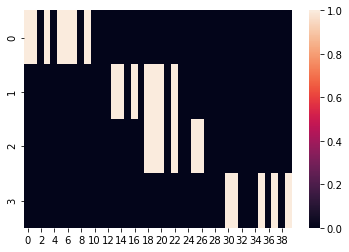

In [166]:
num_neurons = 40
patterns = [np.array([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
                     np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
                     np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
                     np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1]),
           ]
sns.heatmap(patterns)

In [110]:
weights_list = [make_weights(pattern) for pattern in patterns]

weight_changes_slider(weights_list, "Weight matrix ")

In [173]:
weights_sum, weights_expanding_sum = get_weights_expanding_sum(weights_list)

weight_changes_slider(weights_expanding_sum, "Weights cumulative sum of ")

In [176]:
first_activations = np.ones(40)
activations = update_network(first_activations, weights_sum)

Starting the update loop...
    ...pattern [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1] after 1 iterations...
    ...pattern [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1] after 2 iterations...
Done! Got pattern [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1] after 2 iterations


In [177]:
neg_patterns, neg_activations = replace_zero_neg_one(patterns, activations)
calculate_overlaps(neg_patterns, neg_activations, num_neurons)

overlap: [ 1  1 -1  1 -1  1  1  1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1] [ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1] => -0.45
overlap: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1  1 -1  1 -1  1  1  1 -1  1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1] [ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1] => -0.85
overlap: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1  1  1 -1  1 -1
 -1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1] [ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1] => -0.9
overlap: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1  1  1 -1 -1 -1  1 -1  1 -1  1] [ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1  1 -1  1
  1 

See how similar patterns scored in a similar way after all network updates.

In [198]:
principal_components = get_principal_components(np.array(neg_patterns))
data = prepare_data(principal_components, plot_size=100)
plot_energy_landscape(data)

The two middle patterns were so similar that the plane has to be expanded to notice the difference! Noticing this looking at energy was possible with the visualization!

# Addendum: Forgetting
We have seen how a network can learn patterns, but can they forget them?
Let's load data from another implementation of a bigger net to see how weights patterns can be corrupted until only noise remains.
This was achieved by progressively adding Gaussian noise to the network.
If no patterns are updated in the meantime, no patterns will be recalled.

*WARNING: heavier dataset*

In [200]:
weights_forgetting = np.load("forgetting.npy")

In [201]:
weight_changes_slider(weights_forgetting, "Weight matrix ")